## ladestation data

In [1]:
import pandas as pd
import geopandas as gpd



gdf_landkreise = gpd.read_file('../02_data/02_meta_data/vg250_01-01.gk3.shape.ebenen/vg250_ebenen_0101/VG250_KRS.shp')

In [2]:
print(gdf_landkreise.head())

              OBJID     BEGINN  ADE  GF  BSG    ARS    AGS       SDV_ARS  \
0  DEBKGVG200000C75 2022-12-20    4   4    1  01001  01001  010010000000   
1  DEBKGVG200000C76 2022-12-20    4   4    1  01002  01002  010020000000   
2  DEBKGVG200000C77 2024-04-04    4   4    1  01003  01003  010030000000   
3  DEBKGVG200000C78 2022-12-20    4   4    1  01004  01004  010040000000   
4  DEBKGVG200000C79 2024-04-04    4   4    1  01051  01051  010510044044   

            GEN               BEZ  ...  SN_V1 SN_V2 SN_G FK_S3   NUTS  \
0     Flensburg  Kreisfreie Stadt  ...     00    00  000     R  DEF01   
1          Kiel  Kreisfreie Stadt  ...     00    00  000     R  DEF02   
2        Lübeck  Kreisfreie Stadt  ...     00    00  000     R  DEF03   
3    Neumünster  Kreisfreie Stadt  ...     00    00  000     R  DEF04   
4  Dithmarschen             Kreis  ...     00    00  000     R  DEF05   

          ARS_0     AGS_0        WSK            DLM_ID  \
0  010010000000  01001000 2008-01-01  DEBKGDL2

In [3]:
print(gdf_landkreise.info())

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 433 entries, 0 to 432
Data columns (total 26 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   OBJID     433 non-null    object        
 1   BEGINN    433 non-null    datetime64[ms]
 2   ADE       433 non-null    int32         
 3   GF        433 non-null    int32         
 4   BSG       433 non-null    int32         
 5   ARS       433 non-null    object        
 6   AGS       433 non-null    object        
 7   SDV_ARS   433 non-null    object        
 8   GEN       433 non-null    object        
 9   BEZ       433 non-null    object        
 10  IBZ       433 non-null    int32         
 11  BEM       433 non-null    object        
 12  NBD       433 non-null    object        
 13  SN_L      433 non-null    object        
 14  SN_R      433 non-null    object        
 15  SN_K      433 non-null    object        
 16  SN_V1     433 non-null    object        
 17  SN_V2   

In [4]:
print(gdf_landkreise.crs)

EPSG:31467


<Axes: >

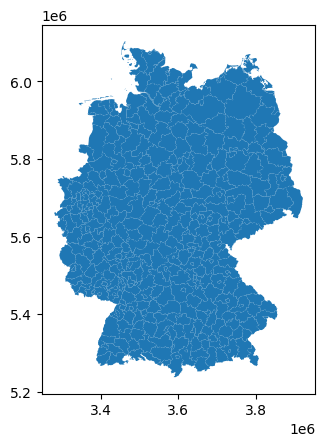

In [5]:
gdf_landkreise.plot()

<Axes: >

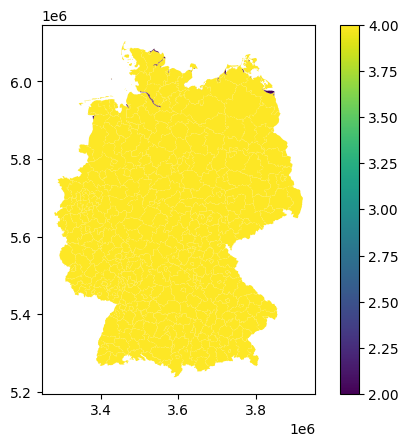

In [6]:
gdf_landkreise.plot(column='GF', cmap='viridis', legend=True)

<Axes: >

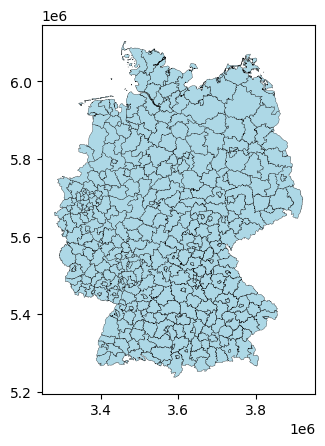

In [7]:
gdf_landkreise.plot(
    facecolor='lightblue',
    edgecolor='black',
    linewidth=0.2
)

<Axes: >

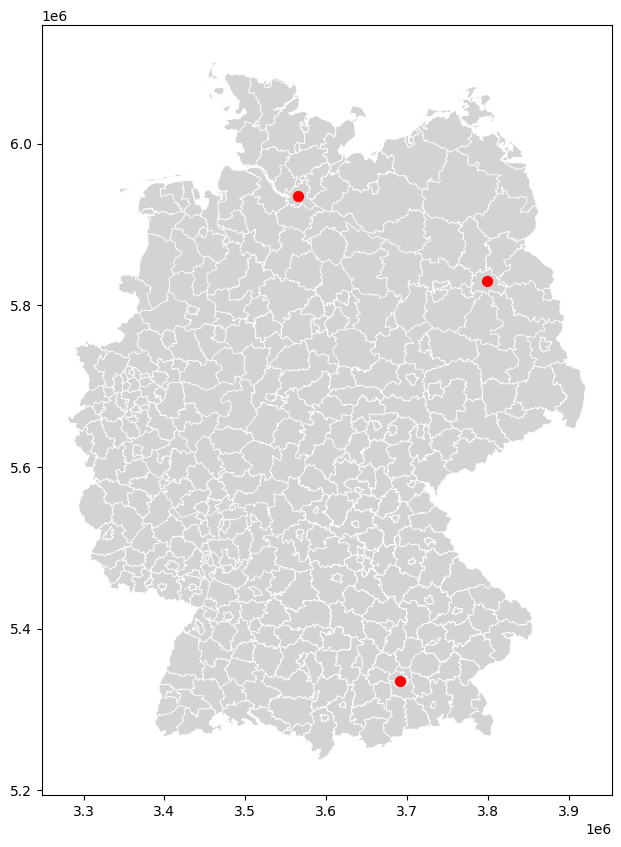

In [8]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point

#sample data for cities
staedte_data = {'Stadt': ['Berlin', 'Hamburg', 'München'],
              'geometry': [Point(13.40, 52.52), Point(9.99, 53.55), Point(11.58, 48.13)]}
gdf_staedte = gpd.GeoDataFrame(staedte_data, crs="EPSG:4326")

# important same CRS for both GeoDataFrames
gdf_staedte = gdf_staedte.to_crs(gdf_landkreise.crs)

# first the districts are plotted and the axis ('ax') is saved
ax = gdf_landkreise.plot(color='lightgray', edgecolor='white', linewidth=0.5, figsize=(10, 10))

# afterwards the cities are plotted on the same axis
gdf_staedte.plot(ax=ax, color='red', markersize=50, label='Städte')

In [ ]:
import pandas as pd
import geopandas as gpd
import folium


gdf_districts_wgs84 = gdf_landkreise.to_crs(epsg=4326)

# 1. Create a copy to work with
gdf_for_map = gdf_districts_wgs84.copy()

# 2. Use a pandas function to find ANY datetime-like column and convert it
for col in gdf_for_map.columns:
    # This function checks for any datetime variation (e.g., [ms], [ns])
    if pd.api.types.is_datetime64_any_dtype(gdf_for_map[col]):
        print(f"Found datetime column '{col}'. Converting it to string.")
        gdf_for_map[col] = gdf_for_map[col].astype(str)

# --- FIX ENDS HERE ---


# Create a map, centered on Germany
german_map = folium.Map(location=[51.16, 10.45], zoom_start=6)

# Now, use the corrected GeoDataFrame ('gdf_for_map') for the map
folium.GeoJson(
    gdf_for_map, # Use the cleaned data
    tooltip=folium.GeoJsonTooltip(fields=['GEN', 'BEZ'],
                                  aliases=['District Name:', 'Type:'])
).add_to(german_map)

# Display the map
german_map

Found datetime column 'BEGINN'. Converting it to string.
Found datetime column 'WSK'. Converting it to string.
